# News Network analysis and Fake news detection 

## Preprocessing

In [1]:
import pandas as pd
df=pd.read_csv("train.csv")

In [2]:
df.head()

,id,title,author,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1


In [3]:
df.describe()

,id,label
count,20800.000000,20800.000000
mean,10399.500000,0.500625
std,6004.587135,0.500012
min,0.000000,0.000000
25%,5199.750000,0.000000
50%,10399.500000,1.000000
75%,15599.250000,1.000000
max,20799.000000,1.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20800 entries, 0 to 20799
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      20800 non-null  int64 
 1   title   20242 non-null  object
 2   author  18843 non-null  object
 3   text    20761 non-null  object
 4   label   20800 non-null  int64 
dtypes: int64(2), object(3)
memory usage: 812.6+ KB


In [5]:
df.isnull().sum()

id           0
title      558
author    1957
text        39
label        0
dtype: int64

In [6]:
df.columns

Index(['id', 'title', 'author', 'text', 'label'], dtype='object')

In [7]:
df=df.drop(['id', 'title'], axis=1)

In [8]:
df.head()

,author,text,label
0,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1


In [9]:
df.isnull().sum()

author    1957
text        39
label        0
dtype: int64

In [10]:
df.shape

(20800, 3)

In [11]:
df = df.dropna()

In [12]:
df.shape

(18843, 3)

In [13]:
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer

In [14]:
import re
port_stem=PorterStemmer()
port_stem

<PorterStemmer>

In [15]:
port_stem.stem("Hi thIs is chando * % %@@@")

'hi this is chando * % %@@@'

In [16]:
def stemming(content):
    con=re.sub('[^a-zA-Z]', ' ', content)
    con=con.lower()
    con=con.split()
    con=[port_stem.stem(word) for word in con if not word in stopwords.words('english')]
    con=' '.join(con)
    return con

In [17]:
stemming('Hi this is Parthan')

'hi parthan'

In [18]:
df['text'] = df['text'].astype(str)

In [19]:
df.head()

,author,text,label
0,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1


# Finding most active author and unique authors

In [20]:
df['author'].nunique()

4201

In [21]:
most_common = df['author'].value_counts().idxmax()
print(most_common)

Pam Key


In [22]:
most_common_count = df['author'].value_counts().max()
print(most_common_count)

243


In [23]:
unique_authors = df['author'].unique()
print(unique_authors)

['Darrell Lucus' 'Daniel J. Flynn' 'Consortiumnews.com' ... 'D. Samuelson'
 'Judge Andrew Napolitano' 'Michael J. de la Merced and Rachel Abrams']


In [24]:
print(len(unique_authors))

4201


# network

In [25]:
import networkx as nx
import random

elements=unique_authors[0:100]

G = nx.Graph()
G.add_nodes_from(elements)

for i in range(len(elements)):
    for j in range(i + 1, len(elements)):
        if random.random() < random.uniform(0.2,0.5):
            G.add_edge(elements[i], elements[j])

In [26]:
import matplotlib.pyplot as plt
fig , ax =plt.subplots(figsize=(200,100))

nx.draw(G, with_labels=False, node_color='black', edge_color='red')

# Display the plot
plt.show()

### degree_centrality

In [27]:
degree_centrality = nx.degree_centrality(G)
nx.degree_centrality(G)

{'Darrell Lucus': 0.26262626262626265,
 'Daniel J. Flynn': 0.25252525252525254,
 'Consortiumnews.com': 0.3434343434343435,
 'Jessica Purkiss': 0.32323232323232326,
 'Howard Portnoy': 0.26262626262626265,
 'Daniel Nussbaum': 0.33333333333333337,
 'Alissa J. Rubin': 0.42424242424242425,
 'Megan Twohey and Scott Shane': 0.32323232323232326,
 'Aaron Klein': 0.30303030303030304,
 'Chris Tomlinson': 0.31313131313131315,
 'Amando Flavio': 0.3535353535353536,
 'Jason Ditz': 0.3434343434343435,
 'AnotherAnnie': 0.33333333333333337,
 'Jack Williams': 0.33333333333333337,
 'Michael Corkery and Stacy Cowley': 0.3535353535353536,
 'Starkman': 0.27272727272727276,
 'The Doc': 0.29292929292929293,
 'Jeff Poor': 0.30303030303030304,
 'Jerome Hudson': 0.4747474747474748,
 'Pam Key': 0.33333333333333337,
 'Donald G. McNeil Jr. and Pam Belluck': 0.37373737373737376,
 'Ira Helfand': 0.26262626262626265,
 'Aaron Klein and Ali Waked': 0.393939393939394,
 'Amanda Shea': 0.2828282828282829,
 'Jim Dwyer': 0.37

In [28]:
node_with_smallest_degree_centrality = min(degree_centrality, key=degree_centrality.get)
print("Node with the smallest degree centrality:", node_with_smallest_degree_centrality,degree_centrality[node_with_smallest_degree_centrality])

Node with the smallest degree centrality: Mac Slavo 0.21212121212121213


In [29]:
node_with_highest_degree_centrality = max(degree_centrality, key=degree_centrality.get)
print("Node with the highest degree centrality:", node_with_highest_degree_centrality,degree_centrality[node_with_highest_degree_centrality])

Node with the highest degree centrality: Jerome Hudson 0.4747474747474748


### closeness_centrality

In [30]:
closeness_centrality = nx.closeness_centrality(G)
nx.closeness_centrality(G)

{'Darrell Lucus': 0.5755813953488372,
 'Daniel J. Flynn': 0.5722543352601156,
 'Consortiumnews.com': 0.6036585365853658,
 'Jessica Purkiss': 0.5963855421686747,
 'Howard Portnoy': 0.5755813953488372,
 'Daniel Nussbaum': 0.6,
 'Alissa J. Rubin': 0.6346153846153846,
 'Megan Twohey and Scott Shane': 0.5963855421686747,
 'Aaron Klein': 0.5892857142857143,
 'Chris Tomlinson': 0.592814371257485,
 'Amando Flavio': 0.6073619631901841,
 'Jason Ditz': 0.6036585365853658,
 'AnotherAnnie': 0.6,
 'Jack Williams': 0.6,
 'Michael Corkery and Stacy Cowley': 0.6073619631901841,
 'Starkman': 0.5789473684210527,
 'The Doc': 0.5857988165680473,
 'Jeff Poor': 0.5892857142857143,
 'Jerome Hudson': 0.6556291390728477,
 'Pam Key': 0.6,
 'Donald G. McNeil Jr. and Pam Belluck': 0.6149068322981367,
 'Ira Helfand': 0.5755813953488372,
 'Aaron Klein and Ali Waked': 0.6226415094339622,
 'Amanda Shea': 0.5823529411764706,
 'Jim Dwyer': 0.6149068322981367,
 'Mark Landler': 0.592814371257485,
 'Ian Hanchett': 0.607361

In [31]:
node_with_smallest_closeness_centrality = min(closeness_centrality, key=closeness_centrality.get)
print("Node with the smallest closeness_centrality:", node_with_smallest_closeness_centrality,closeness_centrality[node_with_smallest_closeness_centrality])

Node with the smallest closeness_centrality: Mac Slavo 0.559322033898305


In [32]:
node_with_highest_closeness_centrality = max(closeness_centrality, key=closeness_centrality.get)
print("Node with the highest closeness_centrality:", node_with_highest_closeness_centrality,closeness_centrality[node_with_highest_closeness_centrality])

Node with the highest closeness_centrality: Jerome Hudson 0.6556291390728477


### betweenness_centrality

In [33]:
betweenness_centrality = nx.betweenness_centrality(G)
nx.betweenness_centrality(G)

{'Darrell Lucus': 0.0036281014741059046,
 'Daniel J. Flynn': 0.0033517247874761207,
 'Consortiumnews.com': 0.006441475157074564,
 'Jessica Purkiss': 0.0046507243404933195,
 'Howard Portnoy': 0.003919034018370403,
 'Daniel Nussbaum': 0.005875455339697038,
 'Alissa J. Rubin': 0.009755395881712436,
 'Megan Twohey and Scott Shane': 0.0069658625900739955,
 'Aaron Klein': 0.005373560698325303,
 'Chris Tomlinson': 0.00639793360407922,
 'Amando Flavio': 0.0071708485182788995,
 'Jason Ditz': 0.007318876797290174,
 'AnotherAnnie': 0.006393681811483631,
 'Jack Williams': 0.006108189936413342,
 'Michael Corkery and Stacy Cowley': 0.006329353967431457,
 'Starkman': 0.004255341532528254,
 'The Doc': 0.004360455881782115,
 'Jeff Poor': 0.004221587773100744,
 'Jerome Hudson': 0.013006065776145104,
 'Pam Key': 0.006421297805961718,
 'Donald G. McNeil Jr. and Pam Belluck': 0.008706631880805856,
 'Ira Helfand': 0.003457185800485091,
 'Aaron Klein and Ali Waked': 0.008033666726264837,
 'Amanda Shea': 0.00

In [34]:
node_with_smallest_betweenness_centrality = min(betweenness_centrality, key=betweenness_centrality.get)
print("Node with the smallest betweenness_centrality:", node_with_smallest_betweenness_centrality,betweenness_centrality[node_with_smallest_betweenness_centrality])

Node with the smallest betweenness_centrality: Mac Slavo 0.0027426329261687906


In [35]:
node_with_highest_betweenness_centrality = max(betweenness_centrality, key=betweenness_centrality.get)
print("Node with the highest betweenness_centrality:", node_with_highest_betweenness_centrality,betweenness_centrality[node_with_highest_betweenness_centrality])

Node with the highest betweenness_centrality: Mike Birbiglia 0.013208530638181929


### eigenvector_centrality

In [36]:
eigenvector_centrality = nx.eigenvector_centrality(G)
nx.eigenvector_centrality(G)

{'Darrell Lucus': 0.07623490367467657,
 'Daniel J. Flynn': 0.07405792163741357,
 'Consortiumnews.com': 0.10158864666704057,
 'Jessica Purkiss': 0.09995422072819841,
 'Howard Portnoy': 0.07532180028373482,
 'Daniel Nussbaum': 0.09947591524488211,
 'Alissa J. Rubin': 0.12442765606956277,
 'Megan Twohey and Scott Shane': 0.09045000339862576,
 'Aaron Klein': 0.0874431499199898,
 'Chris Tomlinson': 0.08772294834451519,
 'Amando Flavio': 0.10140679721201494,
 'Jason Ditz': 0.09709119650120471,
 'AnotherAnnie': 0.09669946547503525,
 'Jack Williams': 0.09781549804431956,
 'Michael Corkery and Stacy Cowley': 0.10699177208829368,
 'Starkman': 0.07948594577277611,
 'The Doc': 0.0872112437011804,
 'Jeff Poor': 0.09337129070095966,
 'Jerome Hudson': 0.13881109141509482,
 'Pam Key': 0.09611355350549858,
 'Donald G. McNeil Jr. and Pam Belluck': 0.10691342281231686,
 'Ira Helfand': 0.07845819704614392,
 'Aaron Klein and Ali Waked': 0.11830256774043461,
 'Amanda Shea': 0.08116911058307463,
 'Jim Dwyer'

In [37]:
node_with_smallest_eigenvector_centrality = min(eigenvector_centrality, key=eigenvector_centrality.get)
print("Node with the smallest betweenness_centrality:", node_with_smallest_eigenvector_centrality,eigenvector_centrality[node_with_smallest_eigenvector_centrality])

Node with the smallest betweenness_centrality: Mac Slavo 0.059015743275351314


In [38]:
node_with_highest_eigenvector_centrality = max(eigenvector_centrality, key=eigenvector_centrality.get)
print("Node with the highest betweenness_centrality:", node_with_highest_eigenvector_centrality,eigenvector_centrality[node_with_highest_eigenvector_centrality])

Node with the highest betweenness_centrality: Jerome Hudson 0.13881109141509482


### Finding the most Influential Node

In [39]:
list_of_highest_centralities =[node_with_highest_degree_centrality,node_with_highest_closeness_centrality,node_with_highest_betweenness_centrality,node_with_highest_eigenvector_centrality]
list_of_highest_centralities

['Jerome Hudson', 'Jerome Hudson', 'Mike Birbiglia', 'Jerome Hudson']

In [40]:
most_influential_node = max(list_of_highest_centralities, key=list_of_highest_centralities.count)

print(most_influential_node)


Jerome Hudson


### Finding Clusters using Girvan-Newman Algorithm

In [41]:
from networkx.algorithms.community.centrality import girvan_newman

communities = girvan_newman(G)

clusters = []
for community in next(communities):
    clusters.append(set(community))

In [42]:
clusters

[{'A. O. Scott',
  'AWR Hawkins',
  'Aaron E. Carroll',
  'Aaron Klein',
  'Aaron Klein and Ali Waked',
  'Activist Post',
  'Admin',
  'Alexandria Laredo',
  'Alissa J. Rubin',
  'Amanda Hess',
  'Amanda Shea',
  'Amando Flavio',
  'Amy Moreno',
  'Andrea Kannapell and Sandra Stevenson',
  'Andrew Higgins',
  'Anonymous Coward (UID 12781064)',
  'AnotherAnnie',
  'Breitbart London',
  'Breitbart News',
  'Brett Anderson',
  'Brian X. Chen',
  'Chris Black',
  'Chris Tomlinson',
  'Clifford Krauss',
  'Consortiumnews.com',
  'Dairy✓ᵀᴿᵁᴹᴾ',
  'Daniel J. Flynn',
  'Daniel Nussbaum',
  'Darrell Lucus',
  'Donald G. McNeil Jr. and Pam Belluck',
  'Dr. Susan Berry',
  'Dylan Gwinn',
  'Edwin Mora',
  'Glenn Thrush, Kate Kelly and Maggie Haberman',
  'Gordon Duff, Senior Editor',
  'Heather Callaghan',
  'Howard Portnoy',
  'Ian Austen',
  'Ian Hanchett',
  'Ian Mason',
  'Ira Helfand',
  'Ivan the Stakhanovets',
  'Jacey Fortin',
  'Jack Healy',
  'Jack Williams',
  'Jane Perlez',
  'Jason 

In [43]:
print("Number of Clusters in the Network : ",len(clusters))

Number of Clusters in the Network :  2


## ML Algorithms

In [44]:
x=df['text']
y=df['label']
y.shape

(18843,)

In [45]:
from sklearn.model_selection import train_test_split
x_train , x_test , y_train, y_test = train_test_split(x, y, test_size=0.20)
from sklearn.feature_extraction.text import TfidfVectorizer
vect=TfidfVectorizer()

In [46]:
x_train=vect.fit_transform(x_train)
x_test=vect.transform(x_test)
x_test.shape

(3769, 142639)

### DecisionTree

In [47]:
from sklearn.tree import DecisionTreeClassifier
model_decision=DecisionTreeClassifier()
model_decision.fit(x_train, y_train)
prediction=model_decision.predict(x_test)

In [48]:
d_tree= model_decision.score(x_test, y_test)
print(d_tree)

0.8861767046962059


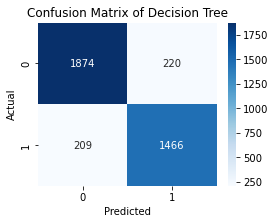

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
# Assuming you have a trained model named 'model', and test data 'x_test' and 'y_test'
y_pred = model_decision.predict(x_test)
# Obtain the confusion matrix
cm = confusion_matrix(y_test, y_pred)
# Create a heatmap of the confusion matrix
fig, ax = plt.subplots(figsize=(4, 3))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", ax=ax)
plt.title('Confusion Matrix of Decision Tree')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### RandomForest

In [50]:
from sklearn.ensemble import RandomForestClassifier

model_forest = RandomForestClassifier(n_estimators=100)
model_forest.fit(x_train, y_train)
prediction = model_forest.predict(x_test)

In [51]:
r_forest=model_forest.score(x_test, y_test)
print(r_forest)

0.9074024940302468


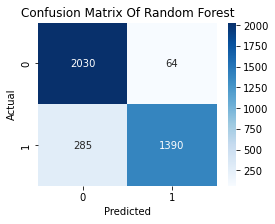

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
y_pred = model_forest.predict(x_test)
cm = confusion_matrix(y_test, y_pred)
fig, ax = plt.subplots(figsize=(4, 3))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", ax=ax)
plt.title('Confusion Matrix Of Random Forest')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### LogisticRegression

In [53]:
from sklearn.linear_model import LogisticRegression

model_logistic = LogisticRegression()
model_logistic.fit(x_train, y_train)
prediction = model_logistic.predict(x_test)

In [54]:
l_regression=model_logistic.score(x_test, y_test)
print(l_regression)

0.949058105598302


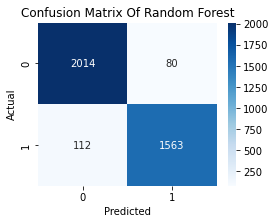

In [55]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
y_pred = model_logistic.predict(x_test)
cm = confusion_matrix(y_test, y_pred)
fig, ax = plt.subplots(figsize=(4, 3))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", ax=ax)
plt.title('Confusion Matrix Of Random Forest')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [56]:
li_scores=[d_tree,r_forest,l_regression]

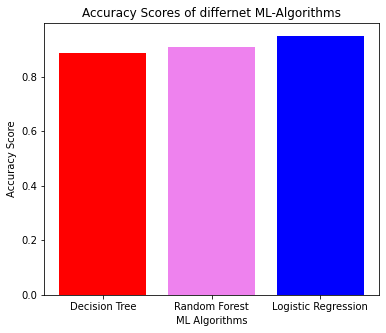

In [57]:
import matplotlib.pyplot as plt
ax = plt.subplots(figsize=(6,5))
plt.bar(["Decision Tree", "Random Forest", "Logistic Regression"], li_scores, color=["red", "violet", "blue"])
plt.ylabel("Accuracy Score")
plt.xlabel("ML Algorithms")
plt.title("Accuracy Scores of differnet ML-Algorithms")
plt.show()

### Observation: Among the 3 Algorithms Logistic Regression has the highest Accuracy